In [1]:
from IPython.display import display
from IPython.display import Image
import os
from utils import * # Code shared across more than one notebook

**Main contributors:** T. Wen, A. Sujar and F. P. Vidal

**Purpose:** In this notebook, we aim to demonstrate that gVirtualXRay is able to generate analytic simulations on GPU comparable to real images from the [Visible Human Project (VHP)](https://www.nlm.nih.gov/research/visible/visible_human.html). We register the data provided by VoxelMan segmented from the cadaver's CT and cryosections onto a pelvis radiograph of the human participant. All the acquisition parameters are unknown and would need to be estimated.

**Material and Methods:** We use the definitions of tissue substitutes provided in the [ICRU Report 44](https://www.icru.org/report/tissue-substitutes-in-radiation-dosimetry-and-measurement-report-44/) by the [International Commission on Radiation Units and Measurements](https://www.icru.org/). <!--The material composition is available at [https://physics.nist.gov/PhysRefData/XrayMassCoef/tab2.html](https://physics.nist.gov/PhysRefData/XrayMassCoef/tab2.html).-->

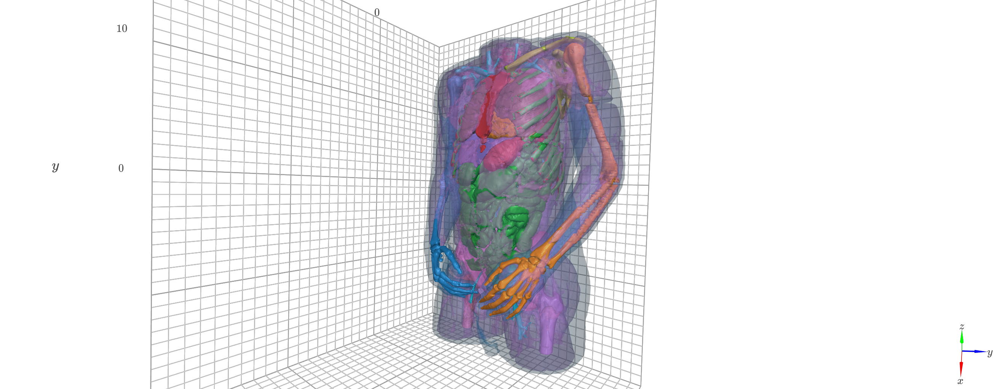

In [2]:
fname = "plots/VHP_model.png"
if os.path.exists(fname):
    display(Image(fname))

**Results:** The **[zero-mean normalised cross-correlation](https://en.wikipedia.org/wiki/Cross-correlation#Zero-normalized_cross-correlation_(ZNCC)) is 58.48%**. 
The **[Structural Similarity Index (SSIM)](https://en.wikipedia.org/wiki/Structural_similarity) is 0.2985**. 

The calculations were performed on the following platform:

In [3]:
printSystemInfo()

OS:
	Linux 5.3.18-150300.59.49-default
	x86_64

CPU:
 	AMD Ryzen 7 3800XT 8-Core Processor

RAM:
	63 GB
GPU:
	Name: GeForce RTX 2080 Ti
	Drivers: 455.45.01
	Video memory: 11 GB


# Import packages

In [4]:
%matplotlib inline

import os # Locate files
from time import sleep

import datetime
import math
import numpy as np # Who does not use Numpy?
import pandas as pd # Load/Write CSV files

import matplotlib
# old_backend =  matplotlib.get_backend() 
# matplotlib.use("Agg")  # Prevent showing stuff

from matplotlib.cm import get_cmap
import matplotlib.pyplot as plt # Plotting
from matplotlib.colors import LogNorm # Look up table
import matplotlib.colors as mcolors

font = {'family' : 'serif',
        #'weight' : 'bold',
         'size'   : 22
       }
matplotlib.rc('font', **font)
matplotlib.rc('text', usetex=True)

from scipy.stats import pearsonr # Compute the correlatio coefficient
from skimage.util import compare_images # Checkboard comparison between two images

from skimage.util import compare_images # Checkboard comparison between two images
from skimage.metrics import structural_similarity as ssim
from sklearn.metrics import mean_absolute_percentage_error as mape
# from skimage.metrics import structural_similarity as ssim
from sklearn.metrics import mean_absolute_error, mean_squared_error
import cv2

from tifffile import imread, imwrite # Load/Write TIFF files

import viewscad # Use OpenSCAD to create STL files

# import pyvista as pv # 3D visualisation
# from pyvista import themes

# import cma # Optimise the parameters of the noise model

import k3d
import random
import base64
from stl import mesh

import urllib, gzip # To download the phantom data, and extract the corresponding Z file


import gvxrPython3 as gvxr # Simulate X-ray images
import json2gvxr # Set gVirtualXRay and the simulation up
from utils import * # Code shared across more than one notebook
import cma # Optimisation

from pymoo.algorithms.moo.nsga2 import NSGA2
from pymoo.factory import get_problem
from pymoo.optimize import minimize
from pymoo.visualization.scatter import Scatter

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import sys

SimpleGVXR 1.0.1 (2022-02-22T14:00:25) [Compiler: GNU g++] on Linux
gVirtualXRay core library (gvxr) 1.1.5 (2022-02-22T14:00:25) [Compiler: GNU g++] on Linux


In [5]:
def standardisation(img):
    return (img - img.mean()) / img.std()

# Reference image

We first load the reference image from the [Visible Human Project](https://www.nlm.nih.gov/databases/download/vhp.html). You can find it at [https://data.lhncbc.nlm.nih.gov/public/Visible-Human/Male-Images/radiological/xray8/x_vm_pe.Z](https://data.lhncbc.nlm.nih.gov/public/Visible-Human/Male-Images/radiological/xray8/x_vm_pe.Z). When you download it, make sure to gunzip it!

In [6]:
if not os.path.exists("VHP"):
    os.mkdir("VHP")

if not os.path.exists("VHP/x_vm_pe.Z"):
    urllib.request.urlretrieve("https://data.lhncbc.nlm.nih.gov/public/Visible-Human/Male-Images/radiological/xray8/x_vm_pe.Z", "VHP/x_vm_pe.Z")
        
if not os.path.exists("VHP/x_vm_pe"):

    gzip_file = gzip.open('VHP/x_vm_pe.Z') # use gzip.open instead of builtin open function
    file_content = gzip_file.read()
    f = open('VHP/x_vm_pe', 'wb')
    f.write(file_content)
    f.close()    

In [7]:
raw_reference = np.fromfile("VHP/x_vm_pe", dtype=np.uint8)
raw_reference.shape = (1536,1248)
raw_reference = np.rot90(raw_reference)

# Crop
y_max = 1000
raw_reference = raw_reference[:y_max]

In [8]:
imwrite('gVirtualXRay_output_data/real_projection-VHP.tif', raw_reference.astype(np.single))

In [9]:
corrected_real_projection = raw_reference.astype(np.single) / 255.0

In [10]:
imwrite('gVirtualXRay_output_data/corrected_real_projection-VHP.tif', corrected_real_projection.astype(np.single))

We plot the image using a linear look-up table and a power-law normalisation.

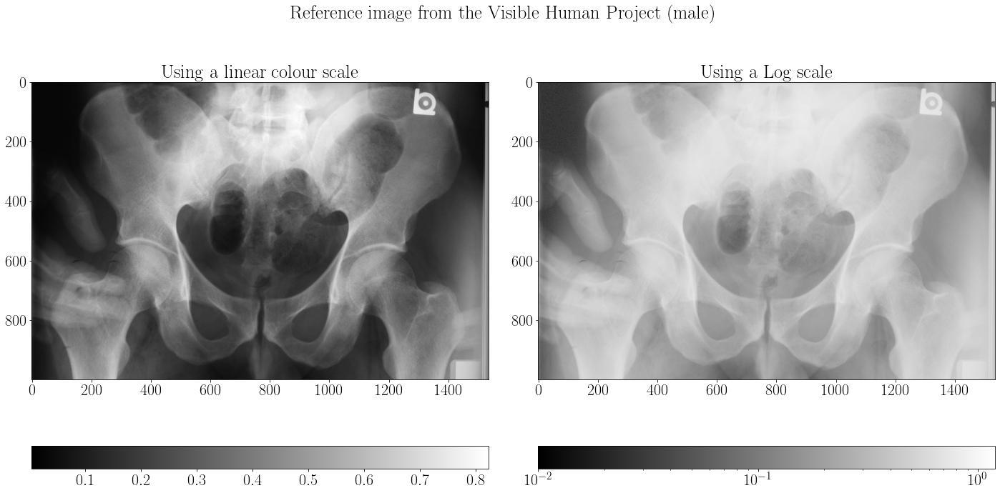

In [11]:
displayLinearPowerScales(corrected_real_projection,
                         "Reference image from the Visible Human Project (male)",
                         "plots/reference-VHP",
                         log=True)

Apply a log transformation

In [12]:
ground_truth = raw_reference
log_ground_truth = np.log(corrected_real_projection)
normalised_log_ground_truth = standardisation(log_ground_truth)

# imwrite('gVirtualXRay_output_data/ground_truth-VHP.tif', ground_truth.astype(np.single))

# Setting up gVirtualXRay

Before simulating an X-ray image using gVirtualXRay, we must create an OpenGL context.

In [13]:
json2gvxr.initGVXR("notebook-8.json", "EGL")

Create an OpenGL context: 800x450
Wed Mar  2 17:56:24 2022 ---- Create window gvxrStatus:	Create window 


0
1.5
4.5.0 NVIDIA 455.45.01



Wed Mar  2 17:56:24 2022 ---- EGL version: Wed Mar  2 17:56:24 2022 ---- OpenGL version supported by this platform OpenGL renderer:   GeForce RTX 2080 Ti/PCIe/SSE2
OpenGL version:    4.5.0 NVIDIA 455.45.01
OpenGL vender:     NVIDIA Corporation
Wed Mar  2 17:56:24 2022 ---- Use OpenGL 4.5.0 0 500 500
0 0 800 450


## X-ray source

We create an X-ray source. It is a point source.

In [14]:
json2gvxr.initSourceGeometry()

Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource


## Spectrum

The spectrum is polychromatic.

In [15]:
spectrum, unit, k, f = json2gvxr.initSpectrum(verbose=0)
energy_set = sorted(spectrum.keys())

count_set = []

for energy in energy_set:
    count_set.append(spectrum[energy])

params["Source"]["Beam"] {'kvp': 85, 'tube angle': 12, 'filter': [['Al', 3.2]]}
['Al', 3.2]


Plot the spectrum

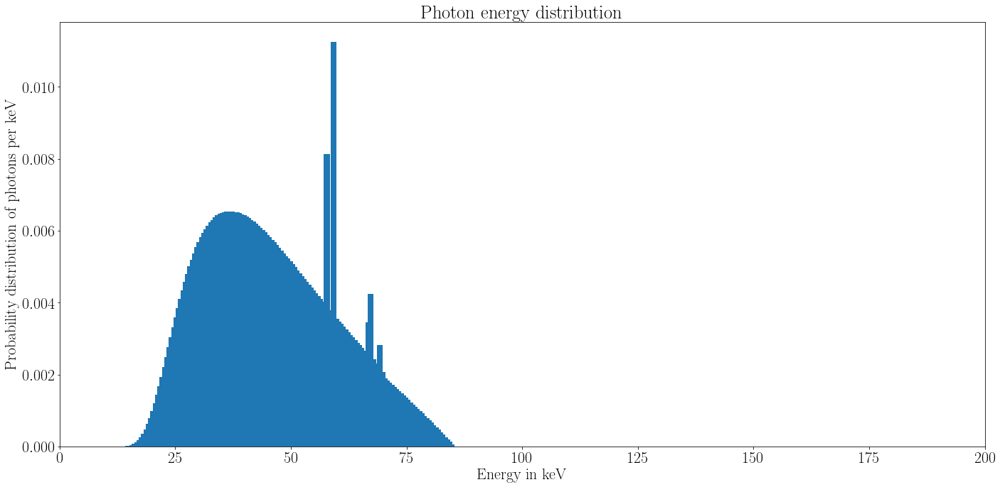

In [16]:
plotSpectrum(k, f, 'plots/spectrum-VHP')

## Detector

Create a digital detector

In [17]:
json2gvxr.initDetector()

Set up the detector
	Detector position: [0.0, -30.5, -20.5, 'cm']
	Detector up vector: [0, -1, 0]
	Detector number of pixels: [1536, 1248]
	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']


## Sample

We now load the models segmented from the Visible Human.

Load the samples. `verbose=2` is used to print the material database for Gate. To disable it, use `verbose=0` or `verbose=1`.

In [18]:
json2gvxr.initSamples(verbose=0)

VHP/meshes/armR.stl	nb_faces:	33838	nb_vertices:	101514	bounding_box (in cm):	(-10.0264, -10.1334, -2.8384)	(0.294166, 10.694, 6.13302)
VHP/meshes/armL.stl	nb_faces:	33475	nb_vertices:	100425	bounding_box (in cm):	(1.14313, -10.7634, -3.28228)	(9.46749, 11.1713, 5.74204)
VHP/meshes/chest.stl	nb_faces:	89235	nb_vertices:	267705	bounding_box (in cm):	(-5.19216, -2.22134, -4.18652)	(5.28961, 12.0778, 3.51821)
VHP/meshes/chest2.stl	nb_faces:	75408	nb_vertices:	226224	bounding_box (in cm):	(-5.20763, -2.213, -4.16399)	(5.26581, 12.0682, 4.06685)
VHP/meshes/femurL.stl	nb_faces:	9660	nb_vertices:	28980	bounding_box (in cm):	(2.2332, -14.6571, -1.851)	(5.5281, -8.86371, 0.57499)
VHP/meshes/femurR.stl	nb_faces:	9660	nb_vertices:	28980	bounding_box (in cm):	(-5.60176, -14.6576, -1.48193)	(-2.25352, -8.82717, 0.79766)
VHP/meshes/hips.stl	nb_faces:	56575	nb_vertices:	169725	bounding_box (in cm):	(-4.86403, -12.1307, -4.17882)	(4.97615, -4.45668, 1.91861)
VHP/meshes/bladder.stl	nb_faces:	2706	nb_ve

In [19]:
number_of_triangles = 0

for sample in json2gvxr.params["Samples"]:
    label = sample["Label"]
    number_of_triangles_in_mesh = gvxr.getNumberOfPrimitives(label)
    number_of_triangles += number_of_triangles_in_mesh
    
    print(label, \
          "has", \
          f"{number_of_triangles_in_mesh:,}", \
          "triangles.")

print("\nThere are", f"{number_of_triangles:,}", "triangles in total")

armR has 33,838 triangles.
armL has 33,475 triangles.
rib cage has 89,235 triangles.
sternum has 75,408 triangles.
femurL has 9,660 triangles.
femurR has 9,660 triangles.
hips has 56,575 triangles.
bladder has 2,706 triangles.
bronch has 1,658 triangles.
circulatory has 28,012 triangles.
gallbladder has 1,172 triangles.
heart has 19,290 triangles.
intestine has 111,010 triangles.
kidney has 18,283 triangles.
liver has 29,688 triangles.
lungs has 68,674 triangles.
muscles has 553,157 triangles.
pancreas has 5,638 triangles.
shoulderL has 12,548 triangles.
shoulderR has 12,454 triangles.
skin has 64,068 triangles.
spine has 22,205 triangles.
spleen has 6,096 triangles.
stomach has 8,928 triangles.

There are 1,273,438 triangles in total


## Visualise the virtual patient

First, apply the scaling factor from voxels to cm.

In [20]:
for anatomy in json2gvxr.params["Samples"]:
    label = anatomy["Label"]
    gvxr.scaleNode(label, 3.3, 3.3, 3.3)
    gvxr.applyCurrentLocalTransformation(label)

Visualise the virtual patient

In [21]:
plot = k3d.plot()
plot.background_color = 0xffffff

for sample in json2gvxr.params["Samples"]:
    
    label = sample["Label"]
    
    fname = sample["Path"]

    r, g, b, a = gvxr.getAmbientColour(label)
    R = math.floor(255*r)
    G = math.floor(255*g)
    B = math.floor(255*b)
    A = math.floor(255*a)

    k3d_color = 0;
    k3d_color |= (R & 255) << 16;
    k3d_color |= (G & 255) << 8;
    k3d_color |= (B & 255);

    mesh_from_stl_file = mesh.Mesh.from_file(fname)

    if label == "skin":
        opacity = 0.2
    elif label == "muscles":
        opacity = 0.3
    else:
        opacity = 1
    geometry = k3d.mesh(mesh_from_stl_file.vectors.flatten(),
                          range(int(mesh_from_stl_file.vectors.flatten().shape[0] / 3)),
                          color=k3d_color, 
                          wireframe=False, 
                          flat_shading=False,
                          name=fname,
                          opacity=opacity)

    plot += geometry   

plot.display()
plot.camera = [17.757085561576094, -0.5941481609904308, 25.327896522760597, -0.2824745178222656, -1.2793889045715332, 0.587073564529419, -0.00450313545724278, 0.9990136450056702, 0.04417531962005856]

Output()

In [22]:
fname = 'plots/VHP_model.png'
if not os.path.isfile(fname):

    sleep(10)
    plot.fetch_screenshot() # Not sure why, but we need to do it twice to get the right screenshot
    sleep(10)
    
    data = base64.b64decode(plot.screenshot)
    with open(fname,'wb') as fp:
        fp.write(data)

## Simulation with the default values

In [23]:
# Backup the transformation matrix
global_matrix_backup = gvxr.getSceneTransformationMatrix()

In [24]:
def getXRayImage():
    global total_energy_in_MeV

    # Compute the X-ray image
    xray_image = np.array(gvxr.computeXRayImage())
    
    # Apply the ROI
    xray_image = xray_image[:y_max]
    
    # Flat-field
#     xray_image /= total_energy_in_MeV
    
    # Negative
    # x_ray_image = 1.0 - x_ray_image
    return xray_image #np.ones(xray_image.shape).astype(np.single) - xray_image

In [25]:
xray_image = getXRayImage()

In [26]:
# gvxr.enableArtefactFilteringOnCPU()
gvxr.enableArtefactFilteringOnGPU()
# gvxr.disableArtefactFiltering() # Spere inserts are missing with GPU integration when a outer surface is used for the matrix

In [27]:
# total_energy_in_keV = 0.0
# for energy, count in zip(energy_set, count_set):
#     effective_energy = find_nearest(detector_response[:,0], energy / 1000, detector_response[:,1])

#     total_energy_in_keV += effective_energy * count
    
total_energy_in_MeV = gvxr.getTotalEnergyWithDetectorResponse()

In [28]:
xray_image = getXRayImage()

In [29]:
gvxr.displayScene()
gvxr.useNegative()

gvxr.setZoom(1569.6787109375)
gvxr.setSceneRotationMatrix([-0.3190782964229584,  -0.15100032091140747, -0.9356207251548767,  0.0,
                              0.002036974299699068, 0.987101674079895,   -0.16000667214393616, 0.0,
                              0.9477221369743347,  -0.05296054854989052, -0.31466084718704224, 0.0, 
                              0.0,                  0.0,                  0.0,                 1.0])

gvxr.setWindowBackGroundColour(0.5, 0.5, 0.5)

gvxr.displayScene()

In [30]:
# gvxr.renderLoop()

In [31]:
# print(gvxr.getZoom())
# print(gvxr.getSceneRotationMatrix())

In [32]:
screenshot = (255 * np.array(gvxr.takeScreenshot())).astype(np.uint8)

In [33]:
fname = 'VHP/default-screenshot.png'
if True:#not os.path.isfile(fname):

    plt.imsave(fname, screenshot)

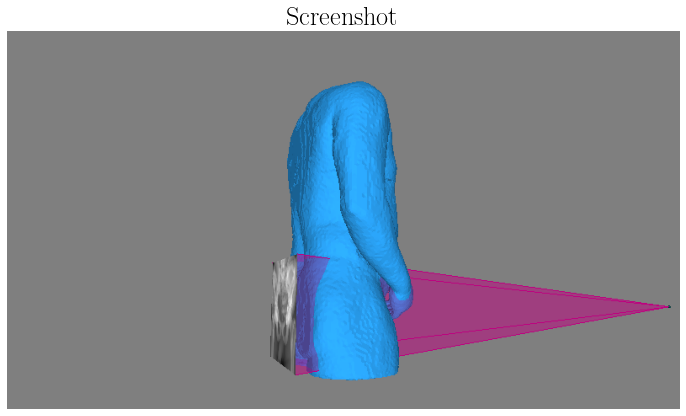

In [34]:
plt.figure(figsize= (10,10))
plt.title("Screenshot")
plt.imshow(screenshot)
plt.axis('off')

plt.tight_layout()

plt.savefig('plots/default-screenshot-beam-on-VHP.pdf')
plt.savefig('plots/default-screenshot-beam-on-VHP.png')

In [35]:
def logImage(xray_image: np.array, min_val: float, max_val: float) -> np.array:
    
    log_epsilon = 1.0e-9

    shift_filter = -math.log(min_val + log_epsilon)
    
    if min_val != max_val:
        scale_filter = 1.0 / (math.log(max_val + log_epsilon) - math.log(min_val + log_epsilon))
    else:
        scale_filter = 1.0

    corrected_image = np.log(xray_image + log_epsilon)

    return (corrected_image + shift_filter) * scale_filter

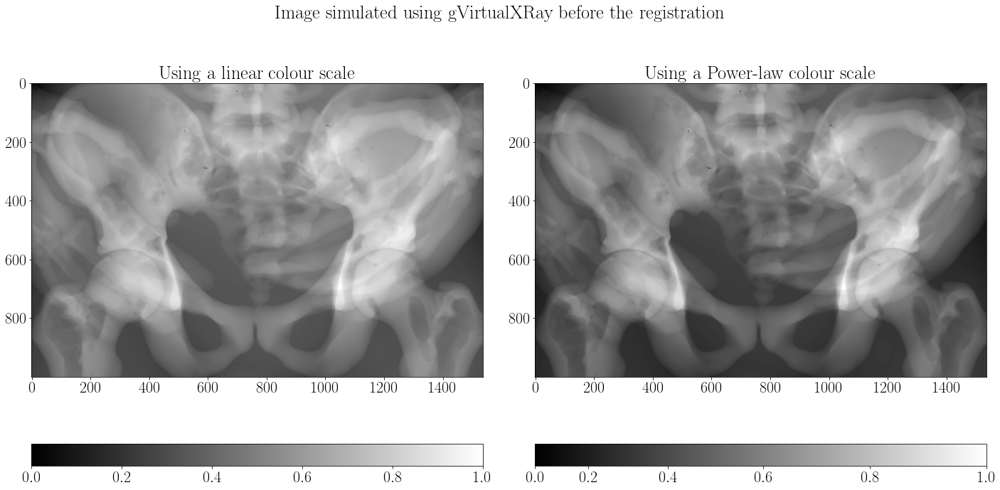

In [36]:
displayLinearPowerScales(1 - logImage(xray_image, xray_image.min(), xray_image.max()),
                         "Image simulated using gVirtualXRay before the registration",
                         "plots/gVirtualXRay-before_registration-VHP",
                         log=False)

# Registration

## Single-objective optimisation with CMA-ES

1st using CMA-ES with 5 different fitness functions, then using NSGA2 and NSGA3.

In [37]:
roi_ground_truth_min = ground_truth.min()
roi_ground_truth_max = ground_truth.max()
standardised_roi_ground_truth = standardisation(ground_truth)

imsave('gVirtualXRay_output_data/standardised_roi_ground_truth-VHP.tif', standardised_roi_ground_truth.astype(np.single))

/tmp/ipykernel_4067/1698494017.py:5: DeprecationWarning: <tifffile.imsave> is deprecated. Use tifffile.imwrite
  imsave('gVirtualXRay_output_data/standardised_roi_ground_truth-VHP.tif', standardised_roi_ground_truth.astype(np.single))


In [38]:
source_position = gvxr.getSourcePosition("cm")
detector_position = gvxr.getDetectorPosition("cm")

x_init = [
    # Orientation of the sample
    0.0, 0.0,

    # Position of the source
    source_position[0],
    source_position[1],
    source_position[2],

    # Position of the detector
    detector_position[0],
    detector_position[1],
    detector_position[2]#,

    # Orientation of the detector
    #     det_rotation_angle1 = x[8]
    #     det_rotation_angle2 = x[9]

#         1.0 / 3.0, # c1
#         1.0, # gain1
#         0.0, # bias1

#         1.0 / 3.0, # c2
#         1.0, # gain2
#         0.0#, # bias2

#         1.0 / 3.0, # c3
#         1.0, # gain3
#         0.0, # bias3
#         2.0 # gamma
]

In [39]:
pos_offset = 20
angle_offset = 5

xl = [
            -angle_offset, -angle_offset, 
            source_position[0] - pos_offset, source_position[1] - pos_offset, source_position[2] - pos_offset,
            detector_position[0] - pos_offset, detector_position[1] - pos_offset, detector_position[2] - pos_offset#,
#             -90, -90, 
#             -10.0,
#             -10.0,
#             -10.0,

#             -10.0,
#             0.0,
#             0.0#,

#             -10.0,
#             -10.0,
#             -10.0,
#             0.0
        ]

xu = [
            angle_offset, angle_offset, 
            source_position[0] + pos_offset, source_position[1] + pos_offset, source_position[2] + pos_offset,
            detector_position[0] + pos_offset, detector_position[1] + pos_offset, detector_position[2] + pos_offset #,
#             90, 90, 
#             10.0,
#             10.0,
#             10.0,

#             10.0,
#             10.0,
#             10.0#,

#             10.0,
#             10.0,
#             10.0,
#             100.0
        ]

In [40]:
def setTransformations(x):
    # Orientation of the sample
    sample_rotation_angle1 = x[0]
    sample_rotation_angle2 = x[1]

    gvxr.rotateScene(sample_rotation_angle1, 1, 0, 0)
    gvxr.rotateScene(sample_rotation_angle2, 0, 1, 0)

    # Position of the source
    source_position_x = x[2]
    source_position_y = x[3]
    source_position_z = x[4]
    
    gvxr.setSourcePosition(
        source_position_x,
        source_position_y,
        source_position_z,
        "cm"
    )
    
    # Position of the detector
    det_position_x = x[5]
    det_position_y = x[6]
    det_position_z = x[7]
    
    gvxr.setDetectorPosition(
        det_position_x,
        det_position_y,
        det_position_z,
        "cm"
    )

    # Orientation of the detector
#     det_rotation_angle1 = x[8]
#     det_rotation_angle2 = x[9]    

In [41]:
def resetToDefaultParameters():
    json2gvxr.initDetector("notebook-8.json")
    json2gvxr.initSourceGeometry("notebook-8.json")
    source_position = gvxr.getSourcePosition("cm")
    detector_position = gvxr.getDetectorPosition("cm")

    # Restore the transformation matrix
    gvxr.setSceneTransformationMatrix(global_matrix_backup)

In [42]:
def updateXRayImage(x):
    
    
    # Backup the transformation matrix
    matrix_backup = gvxr.getSceneTransformationMatrix()

    # Set the transformations
    setTransformations(x)

    # Compute the X-ray image
    xray_image = getXRayImage()

#     gvxr.displayScene()
#     screenshot = gvxr.takeScreenshot()

    # Restore the transformation matrix
    gvxr.setSceneTransformationMatrix(matrix_backup)

    return xray_image #, screenshot

In [43]:
def applyLogScaleAndNegative(image: np.array) -> np.array:
    temp = logImage(image, image.min(), image.max())
    return 1.0 - temp

In [44]:
timeout_in_sec = 20 * 60 # 20 minutes

## Define an objective function

In [45]:
def objectiveFunction(x):
    
    global objective_function_string
    
    global ground_truth, standardised_roi_ground_truth
    global best_fitness, best_fitness_id, fitness_function_call_id, evolution_fitness, evolution_parameters


    xray_image = updateXRayImage(x)
    corrected_xray_image = applyLogScaleAndNegative(xray_image)
    standardised_corrected_xray_image = standardisation(corrected_xray_image)
    
    if objective_function_string == "zncc":
        zncc = np.mean(standardised_roi_ground_truth * standardised_corrected_xray_image)
        dzncc = (1.0 - zncc) / 2.0
        objective = dzncc
    elif objective_function_string == "mae":
        mae = np.mean(np.abs(standardised_roi_ground_truth - standardised_corrected_xray_image))
        objective = mae
    elif objective_function_string == "rmse":
        rmse = math.sqrt(np.mean(np.square(standardised_roi_ground_truth - standardised_corrected_xray_image)))
        objective = rmse
    elif objective_function_string == "ssim":        
        ssim_value = ssim(standardised_roi_ground_truth, standardised_corrected_xray_image, data_range=standardised_roi_ground_truth.max() - standardised_roi_ground_truth.min())
        dssim = (1.0 - ssim_value) / 2.0
        objective = dssim
    elif objective_function_string == "mape":
        # Avoid div by 0
        offset1 = min(standardised_roi_ground_truth.min(), standardised_corrected_xray_image.min())
        offset2 = 0.01 * (standardised_roi_ground_truth.max() - standardised_roi_ground_truth.min())
        offset = offset2 - offset1
        mape_value = mape(standardised_roi_ground_truth + offset, standardised_corrected_xray_image + offset)
        objective = mape_value

    if best_fitness > objective:
            
        evolution_fitness.append([fitness_function_call_id, objective])
        
        row = [fitness_function_call_id]
        for i in x:
            row.append(i)
        evolution_parameters.append(row)
        
        best_fitness = objective
    
    fitness_function_call_id += 1
    
    return objective

In [46]:
def optimiseWithCMAES(objective_function_str: str):

    global objective_function_string
    global best_fitness
    global best_fitness_id
    global fitness_function_call_id
    global evolution_fitness
    global evolution_parameters
    
    resetToDefaultParameters()

    objective_function_string = objective_function_str
    
    source_position = [0.0, 0.0, 0.0]
    detector_position = [0.0, 0.0, 0.0]


    if os.path.exists("gVirtualXRay_output_data/HIPS-" + objective_function_string + ".dat") and \
        os.path.exists("gVirtualXRay_output_data/HIPS_evolution-" + objective_function_string + ".dat") and \
        os.path.exists("gVirtualXRay_output_data/HIPS_evolution_parameters-" + objective_function_string + ".dat"):
        
        temp = np.loadtxt("gVirtualXRay_output_data/HIPS-" + objective_function_string + ".dat")
        
        sample_rotation_angle1 = temp[0]
        sample_rotation_angle2 = temp[1]
        source_position[0] = temp[2]
        source_position[1] = temp[3]
        source_position[2] = temp[4]
        detector_position[0] = temp[5]
        detector_position[1] = temp[6]
        detector_position[2] = temp[7]

        evolution_fitness = np.loadtxt("gVirtualXRay_output_data/HIPS_evolution-" + objective_function_string + ".dat")
        evolution_parameters = np.loadtxt("gVirtualXRay_output_data/HIPS_evolution_parameters-" + objective_function_string + ".dat")

    # CMA-ES
    else:

        opts = cma.CMAOptions()
        opts.set('tolfun', 1e-5)
        opts['tolx'] = 1e-5
        opts['timeout'] = timeout_in_sec
        opts['bounds'] = [xl, xu]

        opts['CMA_stds'] = []

        for min_val, max_val in zip(opts['bounds'][0], opts['bounds'][1]):
            opts['CMA_stds'].append(abs(max_val - min_val) * 0.5)

        best_fitness = sys.float_info.max
        best_fitness_id = 0
        fitness_function_call_id = 0
        evolution_fitness = []
        evolution_parameters = []

        res = cma.fmin(objectiveFunction,
                  x_init,
                  0.5,
                  opts,
                  restarts=0)

        # Save the best individual
        sample_rotation_angle1 = res[0][0]
        sample_rotation_angle2 = res[0][1]
        source_position[0] = res[0][2]
        source_position[1] = res[0][3]
        source_position[2] = res[0][4]
        detector_position[0] = res[0][5]
        detector_position[1] = res[0][6]
        detector_position[2] = res[0][7]

        # Save best parameters from the optimiser
        answer = np.array([sample_rotation_angle1, sample_rotation_angle2, source_position[0], source_position[1], source_position[2], detector_position[0], detector_position[1], detector_position[2]])
        answer = answer.reshape(1, answer.shape[0])
        np.savetxt("gVirtualXRay_output_data/HIPS-" + objective_function_string + ".dat",
                   answer,
                   header='sample_rotation_angle1, sample_rotation_angle2,source_pos_x,source_pos_y,source_pos_z,detector_pos_x,detector_pos_y,detector_pos_z')

        # Save the list of zncc for plotting
        evolution_fitness = np.array(evolution_fitness)
        np.savetxt("gVirtualXRay_output_data/HIPS_evolution-" + objective_function_string + ".dat",
                   evolution_fitness,
                   header='t,' + objective_function_string)

        # Save the list of parameters for plotting
        evolution_parameters = np.array(evolution_parameters)
        print(evolution_parameters.shape)
        
        np.savetxt("gVirtualXRay_output_data/HIPS_evolution_parameters-" + objective_function_string + ".dat",
                   evolution_parameters, 
                   header='t,sample_rotation_angle1,sample_rotation_angle2,source_pos_x,source_pos_y,source_pos_z,detector_pos_x,detector_pos_y,det_position_z')
    
    return [sample_rotation_angle1, sample_rotation_angle2, source_position[0], source_position[1], source_position[2], detector_position[0], detector_position[1], detector_position[2]], \
        evolution_fitness, \
        evolution_parameters

## Run the optimisation for each image comparison method

In [47]:
objective_function_string = "zncc"
x_zncc, evolution_fitness_zncc, evolution_parameters_zncc = optimiseWithCMAES("zncc")

resetToDefaultParameters()
xray_image_zncc = applyLogScaleAndNegative(updateXRayImage(x_zncc))

Set up the detector
	Detector position: [0.0, -30.5, -20.5, 'cm']
	Detector up vector: [0, -1, 0]
	Detector number of pixels: [1536, 1248]
	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']
Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource
(5_w,10)-aCMA-ES (mu_w=3.2,w_1=45%) in dimension 8 (seed=382232, Wed Mar  2 18:08:38 2022)


Iterat #Fevals   function value  axis ratio  sigma  min&max std  t[m:s]
    1     10 2.836667776043340e-01 1.0e+00 4.51e-01  2e+00  9e+00 0:18.1
    2     20 2.722087167261154e-01 1.2e+00 4.44e-01  2e+00  9e+00 0:36.7
    3     30 2.825318498194490e-01 1.3e+00 5.21e-01  3e+00  1e+01 0:52.9
    4     40 2.719996984773466e-01 1.4e+00 5.79e-01  3e+00  1e+01 1:08.4
    5     50 2.800381193296418e-01 1.6e+00 6.06e-01  3e+00  1e+01 1:23.6
    6     60 2.808661065900667e-01 1.7e+00 6.02e-01  3e+00  1e+01 1:39.1
    7     70 3.005600636426897e-01 1.7e+00 6.39e-01  3e+00  1e+01 1:55.8
    8     80 2.773135675967033e-01 2.1e+00 6.01e-01  3e+00  1e+01 2:12.8
    9     90 2.704227129058216e-01 2.0e+00 5.97e-01  3e+00  1e+01 2:29.7
   10    100 2.714359221041655e-01 2.0e+00 5.62e-01  3e+00  1e+01 2:47.1
   11    110 2.835956018054445e-01 2.1e+00 4.98e-01  2e+00  1e+01 3:03.2
   12    120 2.574088704231697e-01 2.0e+00 4.92e-01  2e+00  1e+01 3:20.2
   13    130 2.987913854635590e-01 2.0e+00 4.72e-01 

In [48]:
objective_function_string = "mae"
x_mae, evolution_fitness_mae, evolution_parameters_mae = optimiseWithCMAES("mae")

resetToDefaultParameters()
xray_image_mae = applyLogScaleAndNegative(updateXRayImage(x_mae))

Set up the detector
	Detector position: [0.0, -30.5, -20.5, 'cm']
	Detector up vector: [0, -1, 0]
	Detector number of pixels: [1536, 1248]
	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']
Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource
(5_w,10)-aCMA-ES (mu_w=3.2,w_1=45%) in dimension 8 (seed=358857, Wed Mar  2 18:28:52 2022)


Iterat #Fevals   function value  axis ratio  sigma  min&max std  t[m:s]
    1     10 9.374713948502835e-01 1.0e+00 4.78e-01  2e+00  1e+01 0:19.5
    2     20 9.244753957781333e-01 1.2e+00 4.45e-01  2e+00  9e+00 0:39.8
    3     30 8.644369894435934e-01 1.2e+00 4.69e-01  2e+00  1e+01 0:59.0
    4     40 9.341010149739571e-01 1.4e+00 4.67e-01  2e+00  1e+01 1:16.6
    5     50 8.582970215359739e-01 1.5e+00 5.08e-01  3e+00  1e+01 1:34.6
    6     60 9.363346712354921e-01 1.6e+00 5.01e-01  2e+00  1e+01 1:50.9
    7     70 8.387521979183704e-01 1.7e+00 4.77e-01  2e+00  1e+01 2:07.7
    8     80 8.679412798312346e-01 1.8e+00 4.42e-01  2e+00  1e+01 2:24.2
    9     90 8.098846380278579e-01 1.9e+00 4.02e-01  2e+00  9e+00 2:40.9
   10    100 8.191157486673785e-01 1.9e+00 3.71e-01  2e+00  8e+00 2:57.0
   11    110 8.199907170333630e-01 1.8e+00 3.32e-01  2e+00  7e+00 3:13.0
   12    120 8.427676329563809e-01 1.8e+00 3.46e-01  2e+00  7e+00 3:28.3
   13    130 8.083769665536453e-01 2.1e+00 3.48e-01 

In [49]:
objective_function_string = "rmse"
x_rmse, evolution_fitness_rmse, evolution_parameters_rmse = optimiseWithCMAES("rmse")

resetToDefaultParameters()
xray_image_rmse = applyLogScaleAndNegative(updateXRayImage(x_rmse))

Set up the detector
	Detector position: [0.0, -30.5, -20.5, 'cm']
	Detector up vector: [0, -1, 0]
	Detector number of pixels: [1536, 1248]
	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']
Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource
(5_w,10)-aCMA-ES (mu_w=3.2,w_1=45%) in dimension 8 (seed=366574, Wed Mar  2 18:49:07 2022)


Iterat #Fevals   function value  axis ratio  sigma  min&max std  t[m:s]
    1     10 1.032840372146427e+00 1.0e+00 4.92e-01  2e+00  1e+01 0:19.6
    2     20 1.095233695382328e+00 1.2e+00 4.87e-01  2e+00  1e+01 0:39.9
    3     30 1.074671618044777e+00 1.4e+00 5.26e-01  2e+00  1e+01 0:59.2
    4     40 1.088976626924912e+00 1.5e+00 5.27e-01  2e+00  1e+01 1:16.9
    5     50 1.066972571035801e+00 1.4e+00 5.25e-01  2e+00  1e+01 1:34.7
    6     60 9.745079521465659e-01 1.6e+00 5.17e-01  2e+00  1e+01 1:51.2
    7     70 1.092085603846369e+00 1.7e+00 4.78e-01  2e+00  1e+01 2:08.6
    8     80 1.092252146941009e+00 1.8e+00 5.44e-01  2e+00  1e+01 2:26.6
    9     90 1.039822997874571e+00 2.0e+00 6.39e-01  3e+00  2e+01 2:42.9
   10    100 1.052534907141260e+00 2.1e+00 6.69e-01  3e+00  2e+01 2:59.9
   11    110 1.109753164059375e+00 2.2e+00 6.80e-01  3e+00  2e+01 3:19.1
   12    120 1.145083520371625e+00 2.2e+00 6.78e-01  3e+00  2e+01 3:38.0
   13    130 1.038235843580670e+00 2.3e+00 6.14e-01 

In [50]:
objective_function_string = "ssim"
x_ssim, evolution_fitness_ssim, evolution_parameters_ssim = optimiseWithCMAES("ssim")

resetToDefaultParameters()
xray_image_ssim = applyLogScaleAndNegative(updateXRayImage(x_ssim))

Set up the detector
	Detector position: [0.0, -30.5, -20.5, 'cm']
	Detector up vector: [0, -1, 0]
	Detector number of pixels: [1536, 1248]
	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']
Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource
(5_w,10)-aCMA-ES (mu_w=3.2,w_1=45%) in dimension 8 (seed=377591, Wed Mar  2 19:09:32 2022)


Iterat #Fevals   function value  axis ratio  sigma  min&max std  t[m:s]
    1     10 4.179254522462432e-01 1.0e+00 4.53e-01  2e+00  9e+00 0:19.8
    2     20 4.299147699535565e-01 1.2e+00 4.69e-01  2e+00  9e+00 0:37.9
    3     30 4.471636208509718e-01 1.4e+00 4.32e-01  2e+00  9e+00 0:56.4
    4     40 3.888435899945630e-01 1.5e+00 4.07e-01  2e+00  8e+00 1:15.1
    5     50 3.911052525143428e-01 1.5e+00 4.20e-01  2e+00  9e+00 1:32.8
    6     60 3.880606771210888e-01 1.6e+00 4.39e-01  2e+00  9e+00 1:50.2
    7     70 4.225425229731761e-01 1.6e+00 4.30e-01  2e+00  9e+00 2:06.3
    8     80 4.011443700303535e-01 1.8e+00 4.05e-01  2e+00  8e+00 2:21.6
    9     90 3.879102810946111e-01 1.8e+00 3.54e-01  2e+00  7e+00 2:37.0
   10    100 3.956002631469493e-01 1.9e+00 3.34e-01  1e+00  7e+00 2:52.5
   11    110 3.883144030623428e-01 1.9e+00 3.69e-01  2e+00  8e+00 3:06.9
   12    120 3.869382478612545e-01 2.1e+00 3.87e-01  2e+00  8e+00 3:22.2
   13    130 3.917323290089218e-01 2.2e+00 4.26e-01 

	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']
Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource


In [51]:
objective_function_string = "mape"
x_mape, evolution_fitness_mape, evolution_parameters_mape = optimiseWithCMAES("mape")

resetToDefaultParameters()
xray_image_mape = applyLogScaleAndNegative(updateXRayImage(x_mape))

Set up the detector
	Detector position: [0.0, -30.5, -20.5, 'cm']
	Detector up vector: [0, -1, 0]
	Detector number of pixels: [1536, 1248]


	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']
Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource
(5_w,10)-aCMA-ES (mu_w=3.2,w_1=45%) in dimension 8 (seed=350882, Wed Mar  2 19:29:49 2022)
Iterat #Fevals   function value  axis ratio  sigma  min&max std  t[m:s]
    1     10 2.822432608784872e-01 1.0e+00 4.63e-01  2e+00  1e+01 0:03.6
    2     20 1.928680541588584e-01 1.3e+00 4.19e-01  2e+00  9e+00 0:07.4
    3     30 1.800003967256550e-01 1.3e+00 3.92e-01  2e+00  8e+00 0:11.2
    4     40 2.239860816545852e-01 1.4e+00 3.88e-01  2e+00  8e+00 0:15.0
    6     60 1.868328783947753e-01 1.6e+00 3.91e-01  2e+00  9e+00 0:22.7
    8     80 1.683223790839860e-01 1.8e+00 3.71e-01  2e+00  8e+00 0:30.0
   10    100 1.668113770861747e-01 2.0e+00 3.73e-01  2e+00  9e+00 0:37.3
   12    120 1.779967188057863e-01 2.2e+00 3.76e-01  2e+00  9e+00 0:44.9
   15    150 1.778587877357825e-01 2.4e+00 4.56e-01  2e+00  1e+01 0:56.2
   18    180 1.647347568735913e-01 

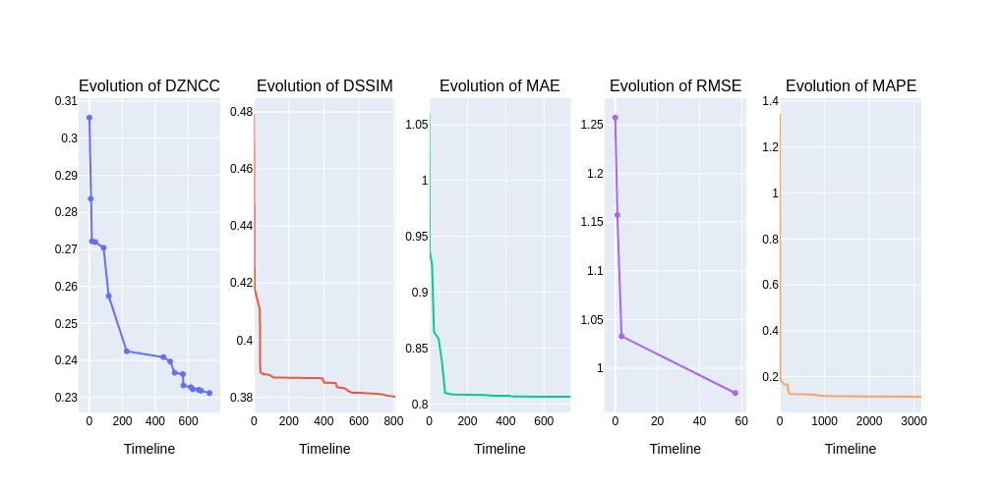

In [52]:
fig = make_subplots(rows=1, cols=5, start_cell="bottom-left",
                    subplot_titles=("Evolution of DZNCC", "Evolution of DSSIM", "Evolution of MAE", "Evolution of RMSE", "Evolution of MAPE"))

# fig.add_trace(go.Scatter(x=evolution_fitness_zncc[:,0], y=1.0 - (2.0 * evolution_fitness_zncc[:,1])),
fig.add_trace(go.Scatter(x=evolution_fitness_zncc[:,0], y=evolution_fitness_zncc[:,1]),
              row=1, col=1)

# fig.add_trace(go.Scatter(x=evolution_fitness_ssim[:,0], y=1.0 - (2.0 * evolution_fitness_ssim[:,1])),
fig.add_trace(go.Scatter(x=evolution_fitness_ssim[:,0], y=evolution_fitness_ssim[:,1]),
              row=1, col=2)

fig.add_trace(go.Scatter(x=evolution_fitness_mae[:,0], y=evolution_fitness_mae[:,1]),
              row=1, col=3)

fig.add_trace(go.Scatter(x=evolution_fitness_rmse[:,0], y=evolution_fitness_rmse[:,1]),
              row=1, col=4)

fig.add_trace(go.Scatter(x=evolution_fitness_mape[:,0], y=evolution_fitness_mape[:,1]),
              row=1, col=5)

# Update xaxis properties
fig.update_xaxes(title_text="Timeline", row=1, col=1)
fig.update_xaxes(title_text="Timeline", row=1, col=2)
fig.update_xaxes(title_text="Timeline", row=1, col=3)
fig.update_xaxes(title_text="Timeline", row=1, col=4)
fig.update_xaxes(title_text="Timeline", row=1, col=5)

# Update yaxis properties
# fig.update_yaxes(title_text="Ojective function: ZNCC", row=1, col=1)
# fig.update_yaxes(title_text="Ojective function: MAE", row=1, col=2)
# fig.update_yaxes(title_text="Ojective function: RMSE", row=1, col=3)
# fig.update_yaxes(title_text="Ojective function: SSIM", row=1, col=4)
# fig.update_yaxes(title_text="Ojective function: MAPE", row=1, col=5)

# fig.update_yaxes(title_text="yaxis 2 title", range=[40, 80], row=1, col=2)
# fig.update_yaxes(title_text="yaxis 3 title", showgrid=False, row=2, col=1)
# fig.update_yaxes(title_text="yaxis 4 title", row=2, col=2)

fig.update_layout(showlegend=False)

fig.update_layout(
    font_family="Arial",
    font_color="black",
    title_font_family="Arial",
    title_font_color="black",
    legend_title_font_color="black"
)

fig.update_layout(
    height=500,
    width=1000
)

fig.write_image("plots/HIPS_evolution-objectives.pdf", engine="kaleido")
fig.write_image("plots/HIPS_evolution-objectives.png", engine="kaleido")

fig.show()

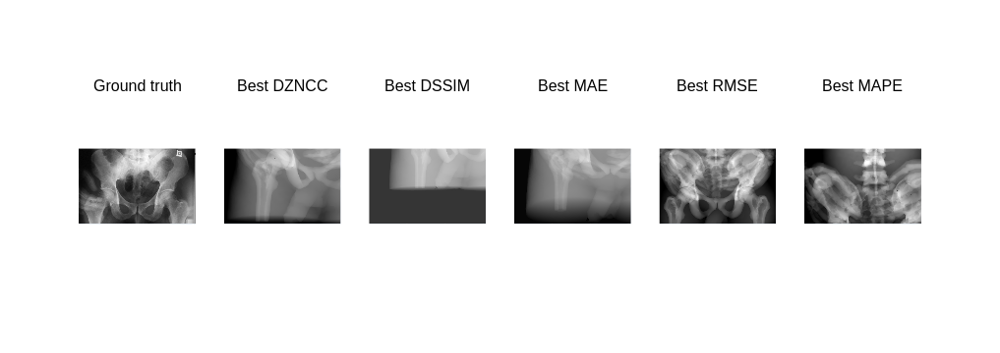

In [53]:
fig = make_subplots(rows=1, cols=6,
                    start_cell="bottom-left",
                    subplot_titles=("Ground truth", "Best DZNCC", "Best DSSIM", "Best MAE", "Best RMSE", "Best MAPE"))

cmaes_img_set = [standardised_roi_ground_truth,
                 standardisation(xray_image_zncc),
                 standardisation(xray_image_ssim), 
                 standardisation(xray_image_mae), 
                 standardisation(xray_image_rmse), 
                 standardisation(xray_image_mape)]

for n, image in enumerate(cmaes_img_set):
    
    im = px.imshow(image, aspect="equal", binary_string=True, zmin=standardised_roi_ground_truth.min(), zmax=standardised_roi_ground_truth.max())
    fig.add_trace(im.data[0], 1, n + 1)

fig.update_xaxes(showticklabels=False) # hide all the xticks
fig.update_yaxes(showticklabels=False) # hide all the yticks
fig.update_layout(coloraxis_showscale=False)

fig.update_layout(
    font_family="Arial",
    font_color="black",
    title_font_family="Arial",
    title_font_color="black",
    legend_title_font_color="black"
)

fig.update_layout(
    height=300,
    width=1200
)

fig.write_image("plots/HIPS_cmaes-objectives.pdf", engine="kaleido")
fig.write_image("plots/HIPS_cmaes-objectives.png", engine="kaleido")

fig.show()

In [54]:
cmaes_x_set   =  [x_zncc, x_mae, x_rmse, x_ssim, x_mape]
cmaes_img_set = [xray_image_zncc, xray_image_mae, xray_image_rmse, xray_image_ssim, xray_image_mape]

temp_res_cmaes = []

for n, [x, image] in enumerate(zip(cmaes_x_set, cmaes_img_set)):
    
    row = copy.deepcopy(x)
    
    xray_image = updateXRayImage(x)
    corrected_xray_image = applyLogScaleAndNegative(xray_image)
    standardised_corrected_xray_image = standardisation(corrected_xray_image)
    
    zncc = np.mean(standardised_roi_ground_truth * standardised_corrected_xray_image)
    row.append((1.0 - zncc) / 2.0)
    
    mae = np.mean(np.abs(standardised_roi_ground_truth - standardised_corrected_xray_image))
    row.append(mae)
    
    rmse = math.sqrt(np.mean(np.square(standardised_roi_ground_truth - standardised_corrected_xray_image)))
    row.append(rmse)
    
    ssim_value = ssim(standardised_roi_ground_truth, standardised_corrected_xray_image, data_range=standardised_roi_ground_truth.max() - standardised_roi_ground_truth.min())
    row.append((1.0 - ssim_value) / 2.0)

    # Avoid div by 0
    offset1 = min(standardised_roi_ground_truth.min(), standardised_corrected_xray_image.min())
    offset2 = 0.01 * (standardised_roi_ground_truth.max() - standardised_roi_ground_truth.min())
    offset = offset2 - offset1
    mape_value = mape(standardised_roi_ground_truth + offset, standardised_corrected_xray_image + offset)
    row.append(mape_value)
        
    temp_res_cmaes.append(row)

In [55]:
df_cmaes = pd.DataFrame(data=temp_res_cmaes,
                  columns=["sample_rotation_angle1", "sample_rotation_angle2", "src_pos_x", "src_pos_y", "src_pos_z", "det_pos_x", "det_pos_y", "det_pos_z", "DZNCC", "MAE", "RMSE", "DSSIM", "MAPE"])

df_cmaes["Optimiser"] = "CMA-ES"
df_cmaes["Optimiser_code"] = 1
df_cmaes.to_csv("gVirtualXRay_output_data/hips-optimiser-cmaes.csv")

In [56]:
display(df_cmaes)

,sample_rotation_angle1,sample_rotation_angle2,src_pos_x,src_pos_y,src_pos_z,det_pos_x,det_pos_y,det_pos_z,DZNCC,MAE,RMSE,DSSIM,MAPE,Optimiser,Optimiser_code
0,-4.991866,1.353755,-18.613038,-17.393354,130.217666,18.218264,-49.387763,-40.499971,0.230849,0.783463,0.960936,0.433716,0.276732,CMA-ES,1
1,4.649052,4.998379,9.078956,-12.151074,154.588780,11.128766,-50.498932,-40.488158,0.269551,0.806452,1.038367,0.412572,0.668308,CMA-ES,1
2,-1.889165,1.161676,12.320442,-43.726923,168.519270,-0.359930,-31.929943,-2.716826,0.237318,0.770913,0.974306,0.361399,0.223484,CMA-ES,1
3,4.905210,4.907635,-17.140402,-50.478928,145.385251,12.226240,-50.499204,-9.327432,0.290274,0.835789,1.077541,0.380203,0.774947,CMA-ES,1
4,-4.999746,-4.085573,-8.004148,-49.225494,130.016563,7.358184,-13.090978,-40.443481,0.329628,0.944848,1.148264,0.473198,0.112777,CMA-ES,1


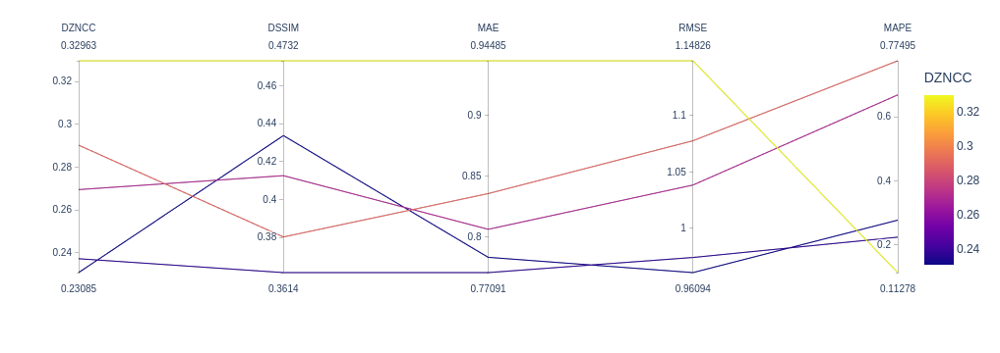

In [57]:
fig = px.parallel_coordinates(df_cmaes[["DZNCC", "DSSIM", "MAE", "RMSE", "MAPE"]], color="DZNCC")
fig.show()

fig.write_image("plots/HIPS-cmaes-parallel_coordinates.pdf", engine="kaleido")
fig.write_image("plots/HIPS-cmaes-parallel_coordinates.png", engine="kaleido")

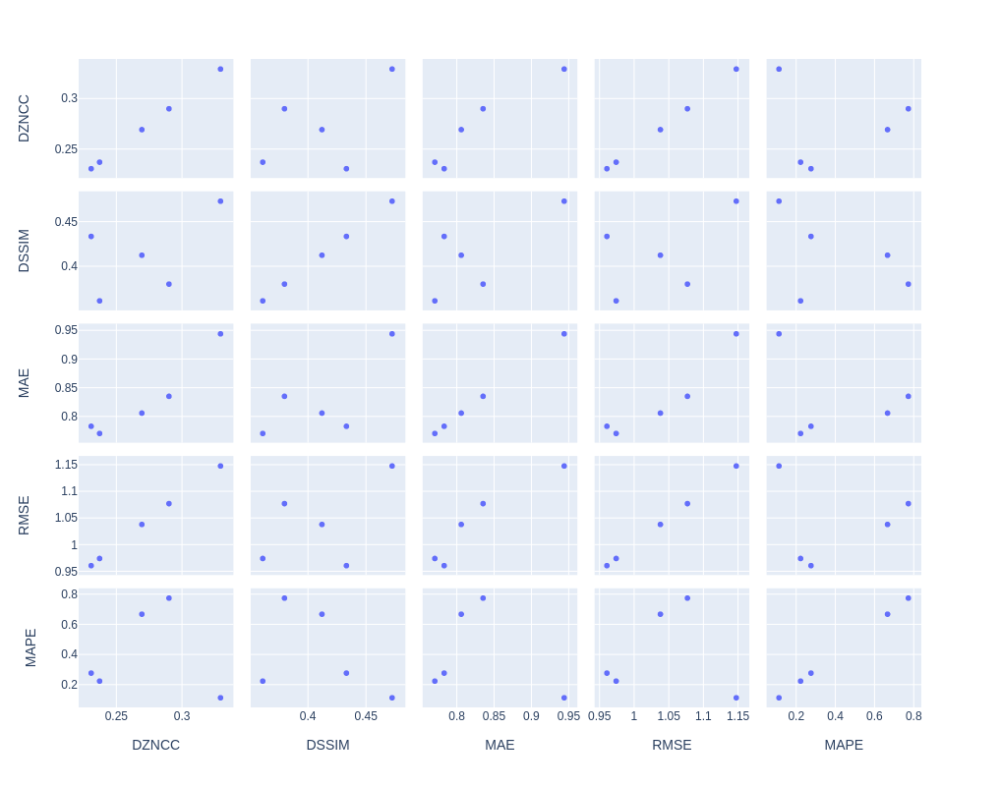

In [58]:
fig = px.scatter_matrix(df_cmaes[["DZNCC", "DSSIM", "MAE", "RMSE", "MAPE"]])

fig.update_layout(
    height=800,
    width=800
)

fig.show()

fig.write_image("plots/HIPS-cmaes-scatter_matrix.pdf", engine="kaleido")
fig.write_image("plots/HIPS-cmaes-scatter_matrix.png", engine="kaleido")

## Multi-objective optimisation with NSGA-II

In [59]:
def objectiveFunctions(x):
    
    global objective_function_string
    
    global ground_truth, standardised_roi_ground_truth
    global best_fitness, best_fitness_id, fitness_function_call_id, evolution_fitness, evolution_parameters

    objectives = []
    
    for ind in x:
        xray_image = updateXRayImage(ind)
        corrected_xray_image = applyLogScaleAndNegative(xray_image)
        standardised_corrected_xray_image = standardisation(corrected_xray_image)

        row = []

        zncc = np.mean(standardised_roi_ground_truth * standardised_corrected_xray_image)
        dzncc = (1.0 - zncc) / 2.0
        row.append(dzncc)

        mae = np.mean(np.abs(standardised_roi_ground_truth - standardised_corrected_xray_image))
        row.append(mae)

        rmse = math.sqrt(np.mean(np.square(standardised_roi_ground_truth - standardised_corrected_xray_image)))
        row.append(rmse)

        ssim_value = ssim(standardised_roi_ground_truth, standardised_corrected_xray_image, data_range=standardised_roi_ground_truth.max() - standardised_roi_ground_truth.min())
        dssim = (1.0 - ssim_value) / 2.0
        row.append(dssim)

        # Avoid div by 0
        offset1 = min(standardised_roi_ground_truth.min(), standardised_corrected_xray_image.min())
        offset2 = 0.01 * (standardised_roi_ground_truth.max() - standardised_roi_ground_truth.min())
        offset = offset2 - offset1
        mape_value = mape(standardised_roi_ground_truth + offset, standardised_corrected_xray_image + offset)
        row.append(mape_value)
    
        objectives.append(row)
        
    return objectives

In [60]:
from pymoo.core.problem import Problem

class MyMultiObjectiveProblem(Problem):

    def __init__(self):
        super().__init__(n_var=len(x_init),
                         n_obj=5,
                         n_constr=0,
                         xl=xl,
                         xu=xu)

    def _evaluate(self, x, out, *args, **kwargs):
        out["F"] = objectiveFunctions(x)

In [61]:
from pymoo.algorithms.moo.nsga2 import NSGA2
from pymoo.optimize import minimize
from pymoo.factory import get_termination
from pymoo.util.termination import collection

resetToDefaultParameters()

problem = MyMultiObjectiveProblem()

pop_size = 210

x_tol_termination = get_termination("x_tol", 1e-5)
f_tol_termination = get_termination("f_tol", 1e-5)
time_termination = get_termination("time", "00:20:00")

termination = collection.TerminationCollection(x_tol_termination, f_tol_termination, time_termination)

if os.path.exists("gVirtualXRay_output_data/VHP-res-nsga2-X.dat") and os.path.exists("gVirtualXRay_output_data/VHP-res-nsga2-F.dat"):

    res_nsga2_X = np.loadtxt("gVirtualXRay_output_data/VHP-res-nsga2-X.dat")
    res_nsga2_F = np.loadtxt("gVirtualXRay_output_data/VHP-res-nsga2-F.dat")

else:

    algorithm = NSGA2(
        pop_size=pop_size,
#         n_offsprings=int(pop_size*0.05),
        eliminate_duplicates=True
    )

    res_nsga2 = minimize(problem,
                   algorithm,
                   termination,
                   seed=1,
                   save_history=True,
                   verbose=True)

    res_nsga2_X = res_nsga2.X
    res_nsga2_F = res_nsga2.F

    np.savetxt("gVirtualXRay_output_data/VHP-res-nsga2-X.dat", res_nsga2_X)
    np.savetxt("gVirtualXRay_output_data/VHP-res-nsga2-F.dat", res_nsga2_F)

Set up the detector
	Detector position: [0.0, -30.5, -20.5, 'cm']
	Detector up vector: [0, -1, 0]
	Detector number of pixels: [1536, 1248]
	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']
Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource


n_gen |  n_eval |  n_nds  |     eps      |  indicator  
    1 |     210 |       6 |            - |            -
    2 |     420 |       7 |  0.154055622 |        ideal
    3 |     630 |       5 |  0.207845299 |        ideal
    4 |     840 |       8 |  0.127065447 |        ideal
    5 |    1050 |       7 |  0.158647150 |        ideal
    6 |    1260 |      13 |  0.172631859 |        ideal
    7 |    1470 |      17 |  0.060337139 |        ideal
    8 |    1680 |      27 |  0.016166080 |        ideal
    9 |    1890 |      31 |  0.093798221 |        ideal
   10 |    2100 |      22 |  0.043846917 |        ideal
   11 |    2310 |      15 |  0.199342023 |        ideal


In [62]:
best_dzncc_id = np.argmin(res_nsga2_F[:,0])
best_mae_id = np.argmin(res_nsga2_F[:,1])
best_rmse_id = np.argmin(res_nsga2_F[:,2])
best_dssim_id = np.argmin(res_nsga2_F[:,3])
best_mape_id = np.argmin(res_nsga2_F[:,4])

print("Lowest DZNCC:", res_nsga2_F[:,0].min(), best_dzncc_id, res_nsga2_X[best_dzncc_id])
print("Lowest DSSIM:", res_nsga2_F[:,3].min(), best_dssim_id, res_nsga2_X[best_dssim_id])
print("Lowest MAE:",   res_nsga2_F[:,1].min(), best_mae_id,   res_nsga2_X[best_mae_id])
print("Lowest RMSE:",  res_nsga2_F[:,2].min(), best_rmse_id,  res_nsga2_X[best_rmse_id])
print("Lowest MAPE:",  res_nsga2_F[:,4].min(), best_mape_id,  res_nsga2_X[best_mape_id])

Lowest DZNCC: 0.2056734187678198 13 [ -4.80017831   2.02236986 -19.38453686 -40.78936236 135.0337335
   1.72300748 -32.71928014  -5.74874761]
Lowest DSSIM: 0.3464964634449592 10 [ -3.4237942    4.2729067    3.51200803 -37.13736563 143.07105177
  -0.29108234 -31.46022789  -3.77390637]
Lowest MAE: 0.7346392266657226 12 [ -2.04779024   3.4534029  -17.62389519 -15.37767021 157.64983682
  -0.44383489 -31.94142827  -3.26032314]
Lowest RMSE: 0.9070246275990965 13 [ -4.80017831   2.02236986 -19.38453686 -40.78936236 135.0337335
   1.72300748 -32.71928014  -5.74874761]
Lowest MAPE: 0.12242530000040054 14 [ -4.80119866   2.25448126 -19.31016859 -42.14669936 130.9075416
   1.76844189 -28.77783655  -6.70479739]


In [63]:
xray_image_dzncc_nsga2 = applyLogScaleAndNegative(updateXRayImage(res_nsga2_X[best_dzncc_id]))
xray_image_mae_nsga2   = applyLogScaleAndNegative(updateXRayImage(res_nsga2_X[best_mae_id]))
xray_image_rmse_nsga2  = applyLogScaleAndNegative(updateXRayImage(res_nsga2_X[best_rmse_id]))
xray_image_dssim_nsga2 = applyLogScaleAndNegative(updateXRayImage(res_nsga2_X[best_dssim_id]))
xray_image_mape_nsga2  = applyLogScaleAndNegative(updateXRayImage(res_nsga2_X[best_mape_id]))

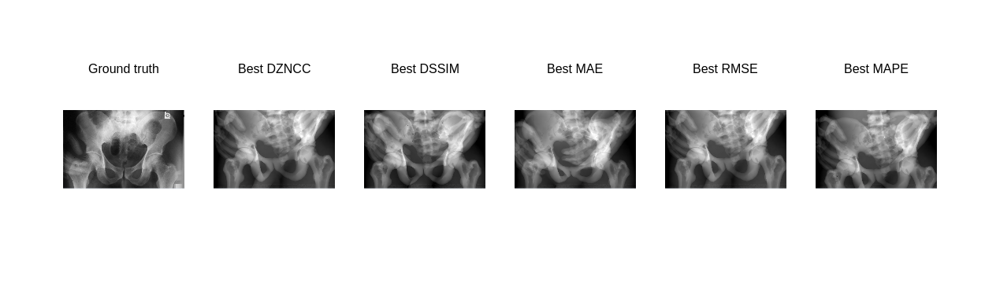

In [64]:
fig = make_subplots(rows=1, cols=6,
                    start_cell="bottom-left",
                    subplot_titles=("Ground truth", "Best DZNCC", "Best DSSIM", "Best MAE", "Best RMSE", "Best MAPE"))

nsga2_img_set = [standardised_roi_ground_truth,
                 standardisation(xray_image_dzncc_nsga2),
                 standardisation(xray_image_dssim_nsga2), 
                 standardisation(xray_image_mae_nsga2), 
                 standardisation(xray_image_rmse_nsga2), 
                 standardisation(xray_image_mape_nsga2)]

for n, image in enumerate(nsga2_img_set):
    
    im = px.imshow(image, aspect="equal", binary_string=True, zmin=standardised_roi_ground_truth.min(), zmax=standardised_roi_ground_truth.max())
    fig.add_trace(im.data[0], 1, n + 1)

fig.update_xaxes(showticklabels=False) # hide all the xticks
fig.update_yaxes(showticklabels=False) # hide all the yticks
fig.update_layout(coloraxis_showscale=False)

fig.update_layout(
    font_family="Arial",
    font_color="black",
    title_font_family="Arial",
    title_font_color="black",
    legend_title_font_color="black"
)

fig.update_layout(
    height=300,
    width=1200
)

fig.write_image("plots/HIPS-NSGA2-objectives.pdf", engine="kaleido")
fig.write_image("plots/HIPS-NSGA2-objectives.png", engine="kaleido")

fig.show()

In [65]:
df_nsga2 = pd.DataFrame(data=np.append(res_nsga2_X, res_nsga2_F, axis=1),
                  columns=["sample_rotation_angle1", "sample_rotation_angle2", "src_pos_x", "src_pos_y", "src_pos_z", "det_pos_x", "det_pos_y", "det_pos_z", "DZNCC", "MAE", "RMSE", "DSSIM", "MAPE"])

df_nsga2["Optimiser"] = "NSGA-II"
df_nsga2["Optimiser_code"] = 2
df_nsga2.to_csv("gVirtualXRay_output_data/hips-optimiser-nsga2.csv")

In [66]:
display(df_nsga2)

,sample_rotation_angle1,sample_rotation_angle2,src_pos_x,src_pos_y,src_pos_z,det_pos_x,det_pos_y,det_pos_z,DZNCC,MAE,RMSE,DSSIM,MAPE,Optimiser,Optimiser_code
0,-4.801199,3.523439,-18.989922,-40.609397,164.568174,1.503564,-30.160007,-6.779000,0.213919,0.756316,0.925027,0.362638,0.183362,NSGA-II,2
1,4.750313,4.546072,4.558581,-12.444532,133.202439,-0.341241,-31.181381,-13.663767,0.237022,0.757029,0.973698,0.360512,0.170156,NSGA-II,2
2,2.716301,4.667951,-17.652187,-27.843845,165.238728,1.767666,-31.933806,-19.616895,0.217337,0.755366,0.932388,0.360125,0.208975,NSGA-II,2
3,4.743385,4.542779,4.558581,-12.444532,133.202439,-0.352418,-31.257200,-13.663767,0.235594,0.755161,0.970761,0.359677,0.170872,NSGA-II,2
4,-0.259423,2.217000,-18.498818,-42.144576,130.848758,1.495441,-29.741233,-5.987344,0.230283,0.786561,0.959756,0.379593,0.147615,NSGA-II,2
5,-0.265537,2.216896,-17.879057,-40.296790,133.436956,0.199370,-29.089868,-5.988549,0.244012,0.794209,0.987952,0.374502,0.138283,NSGA-II,2
6,0.381326,2.216033,-17.879057,-44.193307,133.753225,0.199370,-29.089868,-4.042146,0.242344,0.794814,0.984569,0.375801,0.131265,NSGA-II,2
7,0.860375,4.839917,-15.675989,-20.824581,136.966274,0.720353,-31.925211,-8.374534,0.214098,0.741227,0.925415,0.363188,0.162560,NSGA-II,2
8,0.381326,2.216033,-17.879057,-48.215224,131.941508,0.199370,-29.089868,-2.730746,0.240653,0.795167,0.981128,0.377964,0.132616,NSGA-II,2
9,0.783735,1.997034,-10.238915,-33.544945,136.761226,-0.336469,-31.926204,-6.391126,0.225749,0.748777,0.950262,0.354234,0.197201,NSGA-II,2


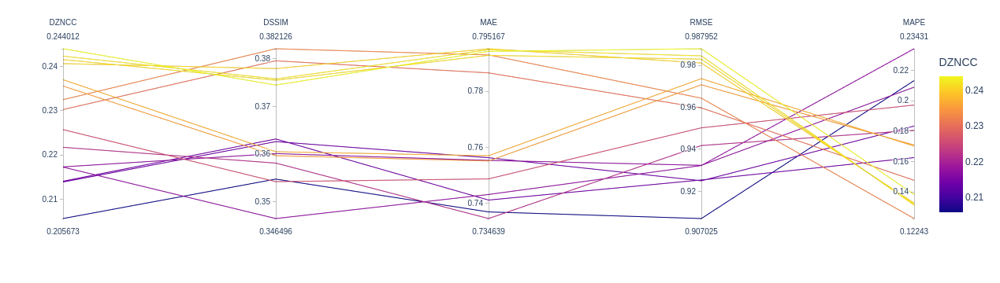

In [67]:
fig = px.parallel_coordinates(df_nsga2[["DZNCC", "DSSIM", "MAE", "RMSE", "MAPE"]], color="DZNCC")
fig.show()

fig.write_image("plots/HIPS-NSGA2-parallel_coordinates.pdf", engine="kaleido")
fig.write_image("plots/HIPS-NSGA2-parallel_coordinates.png", engine="kaleido")

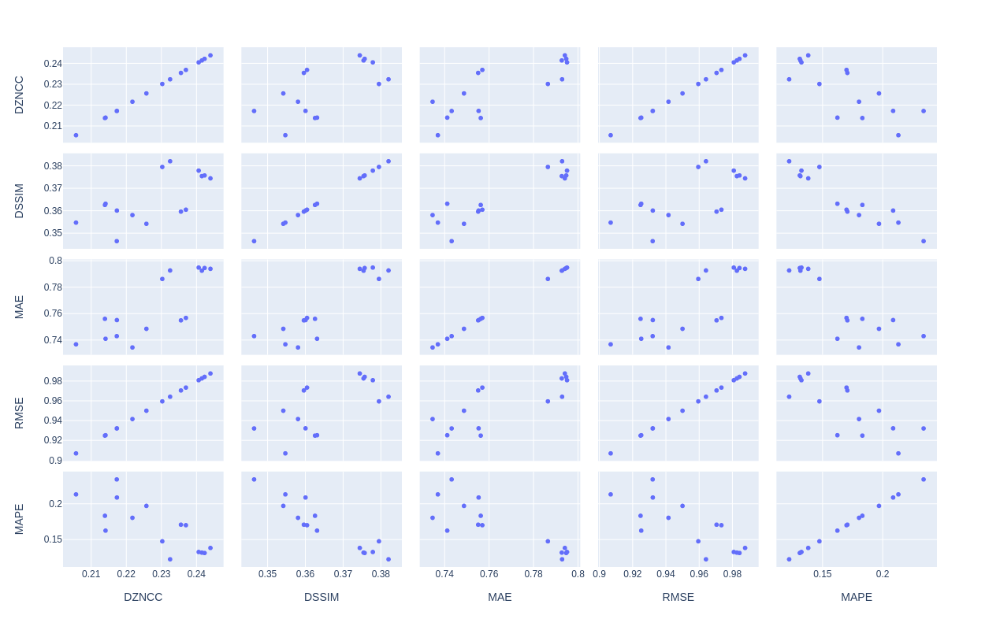

In [68]:
fig = px.scatter_matrix(df_nsga2[["DZNCC", "DSSIM", "MAE", "RMSE", "MAPE"]])

fig.update_layout(
    height=800,
    width=800
)

fig.show()

fig.write_image("plots/HIPS-NSGA2-scatter_matrix.pdf", engine="kaleido")
fig.write_image("plots/HIPS-NSGA2-scatter_matrix.png", engine="kaleido")

In [69]:
runtimes = []

resetToDefaultParameters()
setTransformations(res_nsga2_X[best_dzncc_id])

for i in range(25):
    start_time = datetime.datetime.now()

    raw_x_ray_image = gvxr.computeXRayImage()
    
    end_time = datetime.datetime.now()
    delta_time = end_time - start_time
    runtimes.append(delta_time.total_seconds() * 1000)

Set up the detector
	Detector position: [0.0, -30.5, -20.5, 'cm']
	Detector up vector: [0, -1, 0]
	Detector number of pixels: [1536, 1248]
	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']
Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource


In [70]:
runtime_avg = round(np.mean(runtimes))
runtime_std = round(np.std(runtimes))

raw_x_ray_image = np.array(raw_x_ray_image)

In [71]:
ZNCC = 1.0 - (2.0 * res_nsga2_F[:,0].min())
SSIM = 1.0 - (2.0 * res_nsga2_F[:,3].min())
MAPE = res_nsga2_F[:,4].min()

print("Registration VHP & Real image & " + 
      "{0:0.2f}".format(100 * MAPE) + "\\%    &    " +
      "{0:0.2f}".format(100 * ZNCC) + "\\%    &    " +
      "{0:0.2f}".format(SSIM) + "    &    $" +
      str(raw_x_ray_image.shape[1]) + " \\times " + str(raw_x_ray_image.shape[0]) + "$    &    " +
      str(number_of_triangles) + "    &    " +
      "$" + str(runtime_avg) + " \\pm " + str(runtime_std) + "$ \\\\")

Registration VHP & Real image & 12.24\%    &    58.87\%    &    0.31    &    $1536 \times 1248$    &    1273438    &    $273 \pm 9$ \\


## Single-objective optimisation with NSGA-3

In [72]:
from pymoo.algorithms.moo.nsga3 import NSGA3
from pymoo.factory import get_reference_directions

resetToDefaultParameters()

if os.path.exists("gVirtualXRay_output_data/VHP-res-nsga3-X.dat") and os.path.exists("gVirtualXRay_output_data/VHP-res-nsga3-F.dat"):

    res_nsga3_X = np.loadtxt("gVirtualXRay_output_data/VHP-res-nsga3-X.dat")
    res_nsga3_F = np.loadtxt("gVirtualXRay_output_data/VHP-res-nsga3-F.dat")

else:
    n_objs = 5
    n_partitions = 6

    ref_dirs = get_reference_directions("das-dennis", n_objs, n_partitions=n_partitions)

    problem = MyMultiObjectiveProblem()

    pop_size = 210 #2 * ref_dirs.shape[0]

    algorithm = NSGA3(
        pop_size=pop_size,
#         n_offsprings=int(pop_size*0.05),
        eliminate_duplicates=True,
        ref_dirs=ref_dirs
    )

    res_nsga3 = minimize(problem,
                   algorithm,
                   termination,
                   seed=1,
                   save_history=True,
                   verbose=True)

    res_nsga3_X = res_nsga3.X
    res_nsga3_F = res_nsga3.F

    np.savetxt("gVirtualXRay_output_data/VHP-res-nsga3-X.dat", res_nsga3_X)
    np.savetxt("gVirtualXRay_output_data/VHP-res-nsga3-F.dat", res_nsga3_F)

Set up the detector
	Detector position: [0.0, -30.5, -20.5, 'cm']
	Detector up vector: [0, -1, 0]
	Detector number of pixels: [1536, 1248]
	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']
Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource


n_gen |  n_eval |  n_nds  |     eps      |  indicator  
    1 |     210 |       4 |            - |            -
    2 |     420 |       6 |  0.336456514 |        nadir
    3 |     630 |       4 |  0.587138721 |        ideal
    4 |     840 |       5 |  0.210446306 |        ideal
    5 |    1050 |       4 |  0.215471051 |        ideal
    6 |    1260 |       3 |  1.000000000 |        ideal
    7 |    1470 |       3 |  0.00000E+00 |            f
    8 |    1680 |       6 |  0.182129207 |        ideal
    9 |    1890 |       5 |  0.512255814 |        ideal
   10 |    2100 |       8 |  0.070854951 |        ideal
   11 |    2310 |       9 |  0.017436343 |        ideal


In [73]:
best_dzncc_id = np.argmin(res_nsga3_F[:,0])
best_mae_id = np.argmin(res_nsga3_F[:,1])
best_rmse_id = np.argmin(res_nsga3_F[:,2])
best_dssim_id = np.argmin(res_nsga3_F[:,3])
best_mape_id = np.argmin(res_nsga3_F[:,4])

print("Lowest DZNCC:", res_nsga3_F[:,0].min(), best_dzncc_id, res_nsga3_X[best_dzncc_id])
print("Lowest DSSIM:", res_nsga3_F[:,3].min(), best_dssim_id, res_nsga3_X[best_dssim_id])
print("Lowest MAE:",   res_nsga3_F[:,1].min(), best_mae_id,   res_nsga3_X[best_mae_id])
print("Lowest RMSE:",  res_nsga3_F[:,2].min(), best_rmse_id,  res_nsga3_X[best_rmse_id])
print("Lowest MAPE:",  res_nsga3_F[:,4].min(), best_mape_id,  res_nsga3_X[best_mape_id])

Lowest DZNCC: 0.20215343159590854 2 [ -4.71361951   1.46285025 -18.50315949 -45.34973518 136.32730054
   1.53609435 -30.54058222  -6.83045612]
Lowest DSSIM: 0.34552555335462154 8 [ -3.61910225  -0.69126174 -18.16922549 -40.28953476 143.90974679
   0.29253839 -31.31304627  -4.15908267]
Lowest MAE: 0.7267045616387656 4 [ -4.88084394   0.57293031 -18.27452312 -29.99267438 139.99645013
   0.47330137 -31.87617784  -4.5229943 ]
Lowest RMSE: 0.8992295181896753 2 [ -4.71361951   1.46285025 -18.50315949 -45.34973518 136.32730054
   1.53609435 -30.54058222  -6.83045612]
Lowest MAPE: 0.12654639634134934 7 [ -4.87311646   4.16833171 -18.45080919 -43.65581438 143.38028609
   1.50464372 -28.43888343  -6.82439597]


In [74]:
xray_image_dzncc_nsga3 = applyLogScaleAndNegative(updateXRayImage(res_nsga3_X[best_dzncc_id]))
xray_image_mae_nsga3   = applyLogScaleAndNegative(updateXRayImage(res_nsga3_X[best_mae_id]))
xray_image_rmse_nsga3  = applyLogScaleAndNegative(updateXRayImage(res_nsga3_X[best_rmse_id]))
xray_image_dssim_nsga3 = applyLogScaleAndNegative(updateXRayImage(res_nsga3_X[best_dssim_id]))
xray_image_mape_nsga3  = applyLogScaleAndNegative(updateXRayImage(res_nsga3_X[best_mape_id]))

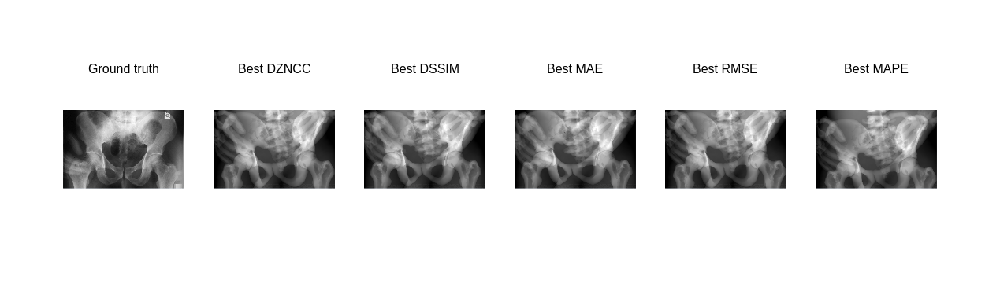

In [75]:
import plotly.express as px

fig = make_subplots(rows=1, cols=6,
                    start_cell="bottom-left",
                    subplot_titles=("Ground truth", "Best DZNCC", "Best DSSIM", "Best MAE", "Best RMSE", "Best MAPE"))

nsga3_img_set = [standardised_roi_ground_truth,
                 standardisation(xray_image_dzncc_nsga3),
                 standardisation(xray_image_dssim_nsga3), 
                 standardisation(xray_image_mae_nsga3), 
                 standardisation(xray_image_rmse_nsga3), 
                 standardisation(xray_image_mape_nsga3)]

for n, image in enumerate(nsga3_img_set):
    
    im = px.imshow(image, aspect="equal", binary_string=True, zmin=standardised_roi_ground_truth.min(), zmax=standardised_roi_ground_truth.max())
    fig.add_trace(im.data[0], 1, n + 1)

fig.update_xaxes(showticklabels=False) # hide all the xticks
fig.update_yaxes(showticklabels=False) # hide all the yticks
fig.update_layout(coloraxis_showscale=False)

fig.update_layout(
    font_family="Arial",
    font_color="black",
    title_font_family="Arial",
    title_font_color="black",
    legend_title_font_color="black"
)

fig.update_layout(
    height=300,
    width=1200
)

fig.write_image("plots/HIPS-NSGA3-objectives.pdf", engine="kaleido")
fig.write_image("plots/HIPS-NSGA3-objectives.png", engine="kaleido")

fig.show()

In [76]:
df_nsga3 = pd.DataFrame(data=np.append(res_nsga3_X, res_nsga3_F, axis=1),
                  columns=["sample_rotation_angle1", "sample_rotation_angle2", "src_pos_x", "src_pos_y", "src_pos_z", "det_pos_x", "det_pos_y", "det_pos_z", "DZNCC", "MAE", "RMSE", "DSSIM", "MAPE"])

df_nsga3["Optimiser"] = "NSGA3"
df_nsga3["Optimiser_code"] = 3
df_nsga3.to_csv("gVirtualXRay_output_data/hips-optimiser-nsga3.csv")

In [77]:
display(df_nsga3)

,sample_rotation_angle1,sample_rotation_angle2,src_pos_x,src_pos_y,src_pos_z,det_pos_x,det_pos_y,det_pos_z,DZNCC,MAE,RMSE,DSSIM,MAPE,Optimiser,Optimiser_code
0,4.710833,-4.915385,12.073449,-20.548692,133.221320,0.433057,-30.870648,-6.397939,0.222325,0.745606,0.943027,0.367337,0.147590,NSGA3,3
1,-3.259530,1.510502,-18.504058,-25.705307,136.327301,1.754844,-31.678266,-6.830456,0.220576,0.765604,0.939311,0.368655,0.175708,NSGA3,3
2,-4.713620,1.462850,-18.503159,-45.349735,136.327301,1.536094,-30.540582,-6.830456,0.202153,0.731139,0.899230,0.350409,0.251203,NSGA3,3
3,3.257878,-4.307683,12.238064,-31.360337,143.829392,0.432507,-30.757385,-4.411907,0.227990,0.752215,0.954967,0.363222,0.181863,NSGA3,3
4,-4.880844,0.572930,-18.274523,-29.992674,139.996450,0.473301,-31.876178,-4.522994,0.204311,0.726705,0.904015,0.346052,0.239707,NSGA3,3
5,4.666708,-4.915385,-18.278564,-20.134696,155.251040,0.466725,-30.870170,-6.426592,0.221552,0.742108,0.941385,0.356851,0.195013,NSGA3,3
6,-3.259530,1.483115,-18.472732,-29.011183,150.982444,1.441053,-31.681522,-6.833707,0.216158,0.756712,0.929856,0.362866,0.181575,NSGA3,3
7,-4.873116,4.168332,-18.450809,-43.655814,143.380286,1.504644,-28.438883,-6.824396,0.234115,0.796302,0.967708,0.384419,0.126546,NSGA3,3
8,-3.619102,-0.691262,-18.169225,-40.289535,143.909747,0.292538,-31.313046,-4.159083,0.207121,0.728398,0.910212,0.345526,0.223553,NSGA3,3


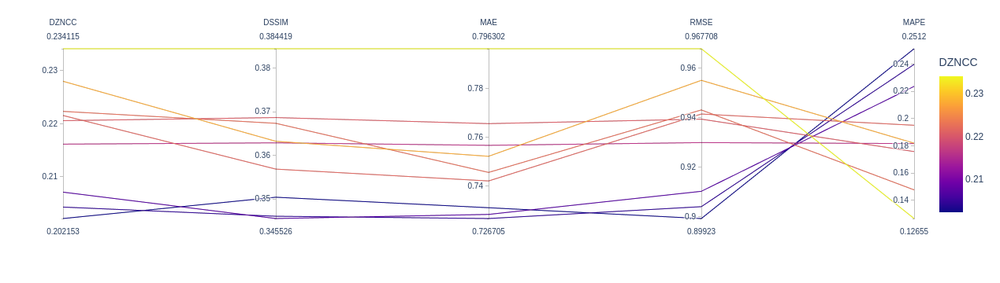

In [78]:
fig = px.parallel_coordinates(df_nsga3[["DZNCC", "DSSIM", "MAE", "RMSE", "MAPE"]], color="DZNCC")
fig.show()

fig.write_image("plots/HIPS-NSGA3-parallel_coordinates.pdf", engine="kaleido")
fig.write_image("plots/HIPS-NSGA3-parallel_coordinates.png", engine="kaleido")

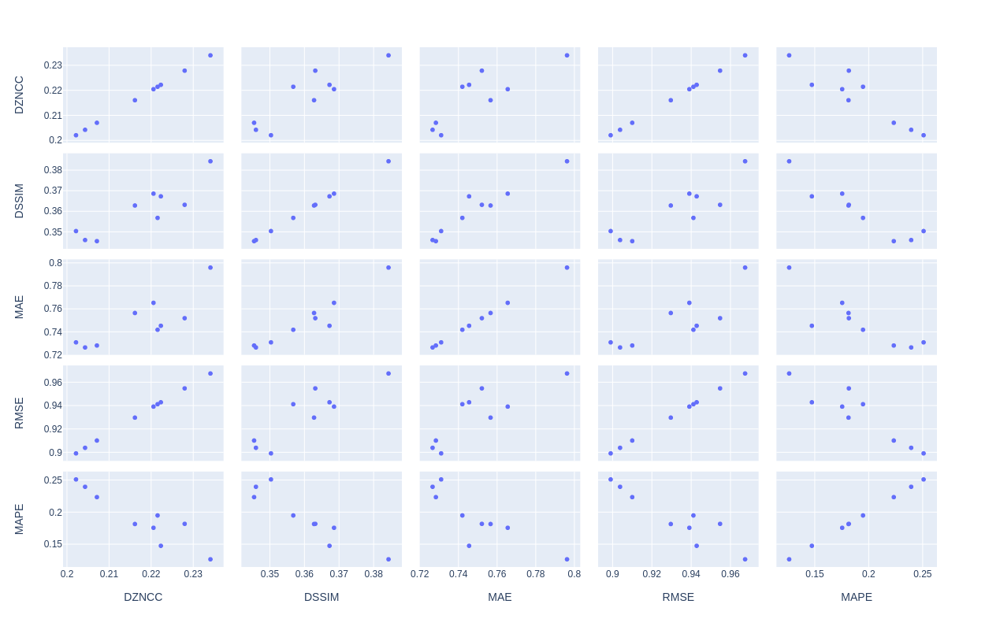

In [79]:
fig = px.scatter_matrix(df_nsga3[["DZNCC", "DSSIM", "MAE", "RMSE", "MAPE"]])

fig.update_layout(
    height=800,
    width=800
)

fig.show()

fig.write_image("plots/HIPS-NSGA3-scatter_matrix.pdf", engine="kaleido")
fig.write_image("plots/HIPS-NSGA3-scatter_matrix.png", engine="kaleido")

# Compare the results obtained with the 3 different optimisation algorithms

In [80]:
df = pd.concat([df_cmaes, df_nsga2, df_nsga3])
df = df.reindex(columns=["Optimiser", "Optimiser_code", "sample_rotation_angle1", "sample_rotation_angle2", "src_pos_x", "src_pos_y", "src_pos_z", "det_pos_x", "det_pos_y", "det_pos_z", "DZNCC", "MAE", "RMSE", "DSSIM", "MAPE"])

df.to_csv("gVirtualXRay_output_data/hips-optimiser.csv")

In [81]:
display(df)

,Optimiser,Optimiser_code,sample_rotation_angle1,sample_rotation_angle2,src_pos_x,src_pos_y,src_pos_z,det_pos_x,det_pos_y,det_pos_z,DZNCC,MAE,RMSE,DSSIM,MAPE
0,CMA-ES,1,-4.991866,1.353755,-18.613038,-17.393354,130.217666,18.218264,-49.387763,-40.499971,0.230849,0.783463,0.960936,0.433716,0.276732
1,CMA-ES,1,4.649052,4.998379,9.078956,-12.151074,154.588780,11.128766,-50.498932,-40.488158,0.269551,0.806452,1.038367,0.412572,0.668308
2,CMA-ES,1,-1.889165,1.161676,12.320442,-43.726923,168.519270,-0.359930,-31.929943,-2.716826,0.237318,0.770913,0.974306,0.361399,0.223484
3,CMA-ES,1,4.905210,4.907635,-17.140402,-50.478928,145.385251,12.226240,-50.499204,-9.327432,0.290274,0.835789,1.077541,0.380203,0.774947
4,CMA-ES,1,-4.999746,-4.085573,-8.004148,-49.225494,130.016563,7.358184,-13.090978,-40.443481,0.329628,0.944848,1.148264,0.473198,0.112777
0,NSGA-II,2,-4.801199,3.523439,-18.989922,-40.609397,164.568174,1.503564,-30.160007,-6.779000,0.213919,0.756316,0.925027,0.362638,0.183362
1,NSGA-II,2,4.750313,4.546072,4.558581,-12.444532,133.202439,-0.341241,-31.181381,-13.663767,0.237022,0.757029,0.973698,0.360512,0.170156
2,NSGA-II,2,2.716301,4.667951,-17.652187,-27.843845,165.238728,1.767666,-31.933806,-19.616895,0.217337,0.755366,0.932388,0.360125,0.208975
3,NSGA-II,2,4.743385,4.542779,4.558581,-12.444532,133.202439,-0.352418,-31.257200,-13.663767,0.235594,0.755161,0.970761,0.359677,0.170872
4,NSGA-II,2,-0.259423,2.217000,-18.498818,-42.144576,130.848758,1.495441,-29.741233,-5.987344,0.230283,0.786561,0.959756,0.379593,0.147615


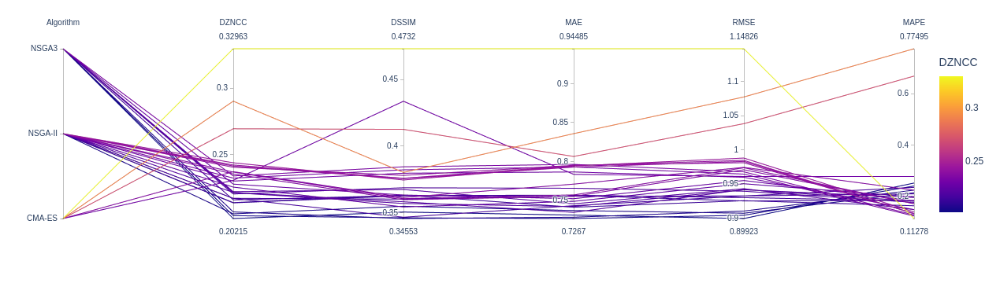

In [82]:
fig = px.parallel_coordinates(df, dimensions=['Optimiser_code', 'DZNCC', 'DSSIM', 'MAE', 'RMSE', 'MAPE'], color="DZNCC")
fig.data[0]["dimensions"][0]["label"] = "Algorithm"
fig.data[0]["dimensions"][0]["ticktext"] = ["CMA-ES", "NSGA-II", "NSGA3"]
fig.data[0]["dimensions"][0]["tickvals"] = [1, 2, 3]
fig.show()

fig.write_image("plots/HIPS-ALL-parallel_coordinates.pdf", engine="kaleido")
fig.write_image("plots/HIPS-ALL-parallel_coordinates.png", engine="kaleido")

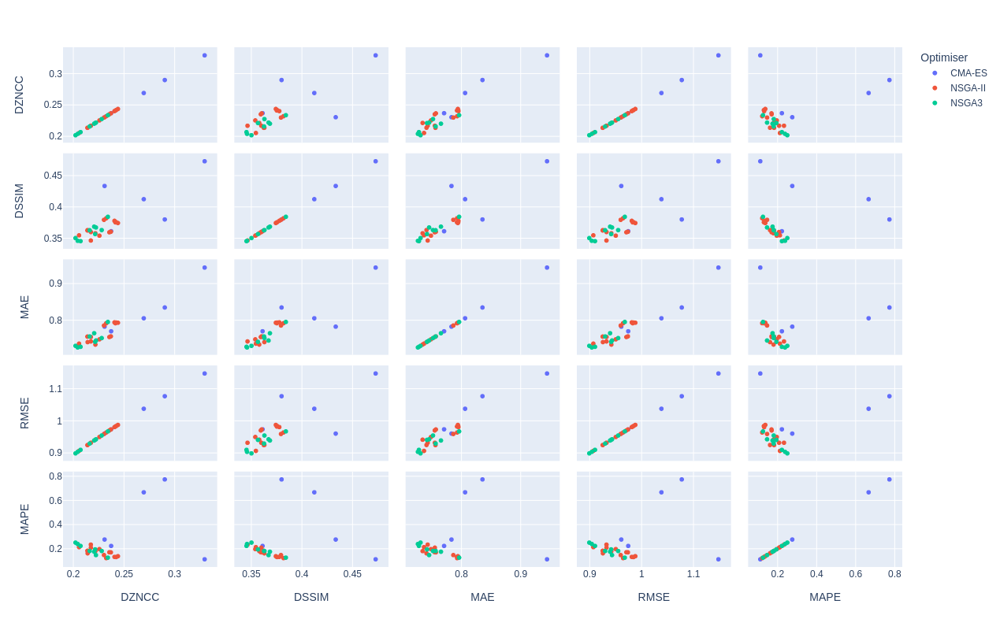

In [83]:
fig = px.scatter_matrix(df,
    dimensions=["DZNCC", "DSSIM", "MAE", "RMSE", "MAPE"],
    color="Optimiser")

fig.update_layout(
    height=800,
    width=800
)

fig.show()

fig.write_image("plots/HIPS-ALL-scatter_matrix.pdf", engine="kaleido")
fig.write_image("plots/HIPS-ALL-scatter_matrix.png", engine="kaleido")

# Performance analysis

In [84]:
runtimes = []

resetToDefaultParameters()
setTransformations(res_nsga3_X[best_dzncc_id])

for i in range(25):
    start_time = datetime.datetime.now()

    raw_x_ray_image = gvxr.computeXRayImage()
    
    end_time = datetime.datetime.now()
    delta_time = end_time - start_time
    runtimes.append(delta_time.total_seconds() * 1000)

Set up the detector
	Detector position: [0.0, -30.5, -20.5, 'cm']
	Detector up vector: [0, -1, 0]
	Detector number of pixels: [1536, 1248]
	Pixel spacing: [0.026347682927083334, 0.026347683, 'cm']
Set up the beam
	Source position: [0.0, -30.5, 150.0, 'cm']
	Source shape: PointSource


In [85]:
runtime_avg = round(np.mean(runtimes))
runtime_std = round(np.std(runtimes))

raw_x_ray_image = np.array(raw_x_ray_image)

In [86]:
ZNCC = 1.0 - (2.0 * res_nsga3_F[:,0].min())
SSIM = 1.0 - (2.0 * res_nsga3_F[:,3].min())
MAPE = res_nsga3_F[:,4].min()

print("Registration VHP & Real image & " + 
      "{0:0.2f}".format(100 * MAPE) + "\\%    &    " +
      "{0:0.2f}".format(100 * ZNCC) + "\\%    &    " +
      "{0:0.2f}".format(SSIM) + "    &    $" +
      str(raw_x_ray_image.shape[1]) + " \\times " + str(raw_x_ray_image.shape[0]) + "$    &    " +
      str(number_of_triangles) + "    &    " +
      "$" + str(runtime_avg) + " \\pm " + str(runtime_std) + "$ \\\\")

Registration VHP & Real image & 12.65\%    &    59.57\%    &    0.31    &    $1536 \times 1248$    &    1273438    &    $276 \pm 9$ \\


# Comparison of the analytic simulation with the real radiograph


In [87]:
data = [
    [
        "CMA-ES",
        np.max(1.0 - (2.0 * evolution_fitness_zncc[:,1])), 
        np.max(1.0 - (2.0 * evolution_fitness_ssim[:,1])), 
        np.min(evolution_fitness_mae[:,1]), 
        np.min(evolution_fitness_rmse[:,1]), 
        np.min(evolution_fitness_mape[:,1])
    ],
    
    [
        "NSGA-II",
        np.max(1.0 - (2.0 * res_nsga2_F[:,0])), 
        np.max(1.0 - (2.0 * res_nsga2_F[:,3])), 
        np.min(res_nsga2_F[:,1]), 
        np.min(res_nsga2_F[:,2]), 
        np.min(res_nsga2_F[:,4])
    ],
    
    [
        "NSGA-3",
        np.max(1.0 - (2.0 * res_nsga3_F[:,0])), 
        np.max(1.0 - (2.0 * res_nsga3_F[:,3])), 
        np.min(res_nsga3_F[:,1]), 
        np.min(res_nsga3_F[:,2]), 
        np.min(res_nsga3_F[:,4])
    ]
]

df = pd.DataFrame(data=data,
                  columns=["Optimisation algorithm", "ZNCC", "SSIM", "MAE", "RMSE", "MAPE"])

df.to_csv("gVirtualXRay_output_data/hips-results.csv")

print(df)


  Optimisation algorithm      ZNCC      SSIM       MAE      RMSE      MAPE
0                 CMA-ES  0.537588  0.239609  0.806462  0.974508  0.112776
1                NSGA-II  0.588653  0.307007  0.734639  0.907025  0.122425
2                 NSGA-3  0.595693  0.308949  0.726705  0.899230  0.126546


# All done

Destroy the window

In [88]:
gvxr.destroyAllWindows()


0(0x556de111e0b0)
